# Engineering ideas behind AlphaFold2
## (Sberloga 24.12.2021)


## Contents
* Problem statement and principle of operation
* Data flow
  * Sequence data: Uniprot, Mgnify; software: HMMER
  * Structure data: PDB; software: HHpred, OpenMM
  * Evoformer: MSA embeddings and pair distances iterative refinement
  * Structure module: 3D structure from a sequence in MSA embedding
* Evoformer: MSA embeddings and pair distances refinement
  * Attention mechanism
  * Criss-cross (axial) attention
  * Row-wise gated self-attention, augmented with pair distances information
  * Column-wise gated self-attention
  * Pair distances update from MSA embedding through outer product
  * Triangle multiplicative update
  * Triangle attention
* Structure module
  * Invariant-point attention (IPA), SE(3)-equivariance
* Refinement/recycling
* Self-distillation
* Loss function(s): FAPE and auxiliary losses
* Training protocol and ablations

In [2]:
import matplotlib.pyplot as plt
import numpy as np

from IPython.display import Image

## Problem statement
* Proteins are linear sequences of monomers - aminoacids - that fold in complex 3D structures. Protein 3D structures are useful for understanding their function and drug discovery. 
* Reading protein sequences is cheap and can be achieved directly by mass-spectrometry (\\$100 per sample) or indirectly by DNA genome/exome sequencing (\\$100-1000 per sequence). Experimental discovery of 3D structures of proteins is much more expensive (\\$100k-1M per structure) and is done by X-ray/MRI crystallography.
* Typical pipeline for X ray structure prediction consists of protein crystallizaiton (which is hard for membrane proteins, as they are not very soluble), X ray diffration on the resulting crystal and intepretation of the resulting maps of electron density (which is about 10-20% arbitrary).
* Protein sequences are available in Uniprot (about 200M proteins) and MGnify databases.
* Protein structures are available in PDB database (about 200K protein structures).

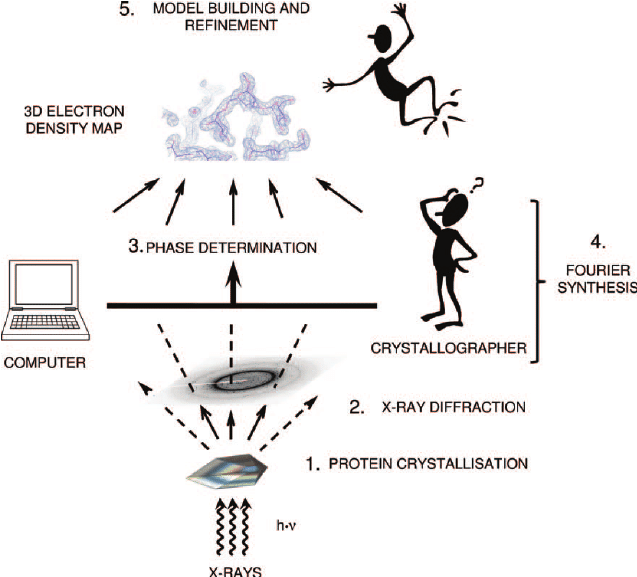

In [7]:
Image("./img/x_ray_crystallography.png")

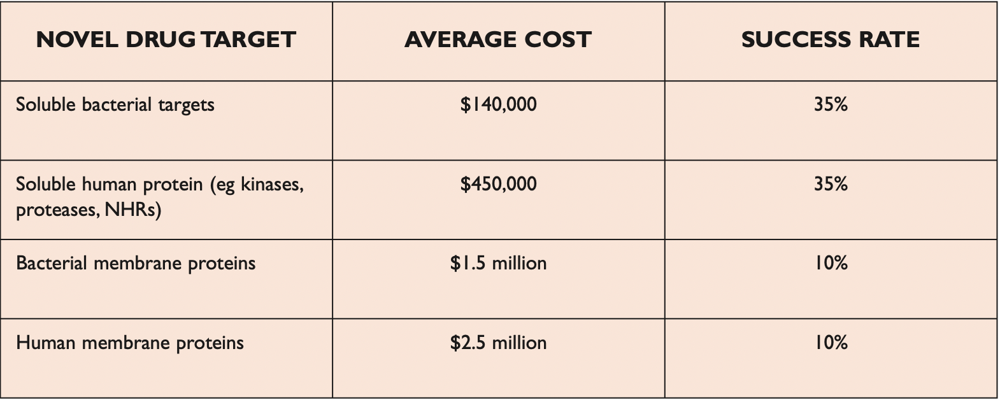

In [22]:
Image("./img/cost_and_success_rate_of_x_ray.png", width=1080)

## AlphaFold2 principle of operation
* Protein 3D structure prediction *in silico*, based on pure physics, generally can not achieve performance, comparable to experiment. Statistics-based approach proved to be more effective.
* Oftentimes a protein is conservative in evolution. E.g. human, horse and fish have their own versions of haemoglobin that evolved from the same protein. Such versions of the same protein in different species are called homologues.
* Evolution is mostly neutral (i.e. most of the mutations don't affect the protein function). Protein structure is more conservative than its sequence. It is typical for a sequence to change by 70% between distant species, while the 3D structure stays more or less the same. Comparison of homologues from different species carries important information and is usually represented as a 2D table, called multiple sequence alignment (MSA). Protein sequences from different species are written in rows, so that corresponding residues end up in the same columns.
* Conservation of a position in alignment usually implies its importance for protein folding or function (e.g. catalytic activity, interactions with ligands, recognition of binding sites).
* Coevolution of two aminoacid residues of a protein often implies interaction between those aminoacids.

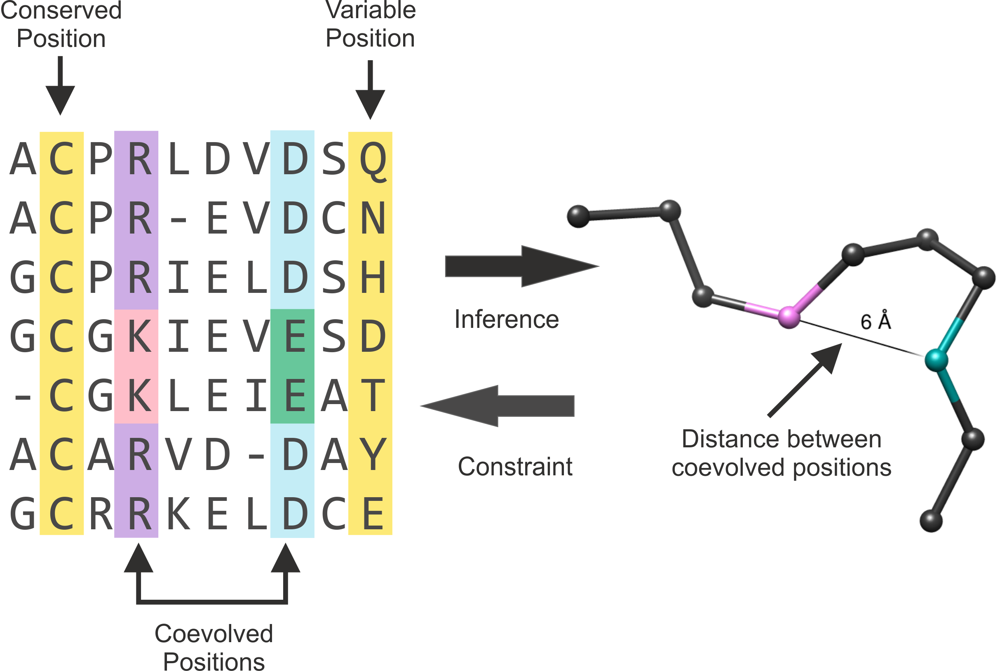

In [26]:
Image("./img/coevolution_explained.png", width=1080)

# AlphaFold2 pipeline
* Use HMMER to find homologues of input sequence in Uniprot and MGnify. Construct mutiple sequence alignment (MSA) of homologues.
* Optionally use HHpred to find templates of 3D structure of the given protein in PDB. Construct pair representation of distances between residues from 3D structure.
* Generate MSA embedding.
* Pass MSA embedding and pair representations on input of an end-to-end transformer-based neural network.
* Use Evoformer module of neural network to iteratively update MSA embedding and pair representation.
* Use Structural module of neural network to iteratively predict 3D structure of protein from one sequence of MSA embedding and pair representation.
* Use OpenMM to relax the obtained 3D structure with physics-based methods.
* Recycle the structure thrice.

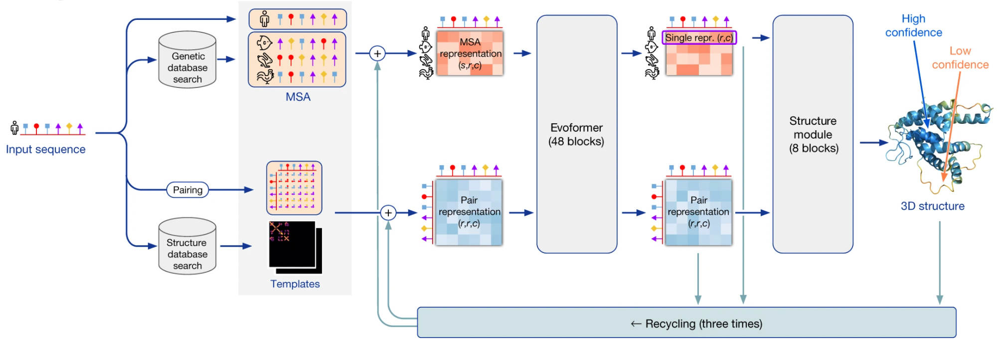

In [65]:
Image("./img/AF2_bird_eye_view.png", width=1400)

# Evoformer module

* Consists of 48 identical blocks that take MSA embedding and pair representation on input and produce their refined version as output
* Each block consists of 2 attention-based parts: gated axial self-attention part and triangle inequality enforcement part, which are connected by outer product mean

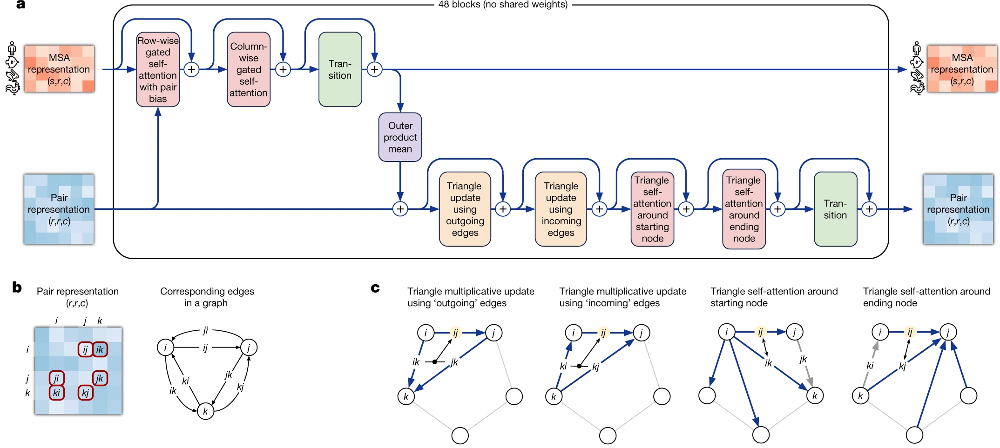

In [24]:
Image("./img/evoformer.png", width=1280)

## Attention and transformer architecture
* Attention mechanism has been popularized circa 2014-2015 for machine translation (e.g. English-to-French)
* By 2017 it became clear that attention mechanism is a self-sufficient building block, serving as a powerful alternative to both CNN and RNN in both NLP and CV problems, as well as in problems, related to other modalities.
* This gave rise to purely attention-based architectures, called transformers. 

## Scaled dot-product attention
* We pass a sentence on input. For each word we generate its embedding. We want to enrich embedding for each word with context information from other words. 
* Key-value database analogy: queries (Q), keys (K) and values (V). 
* Each input word's embedding is a query; the output is a weighted sum of this word's embedding with related words embeddings. Weights in this sum reflect some relation between query and key (in the course of training, the neural network learns those relations).
* Each attention layer learns $h$ relations. Each relation is learnt by a separate attention head. In a way, attention heads are similar to convolution filters of CNNs.

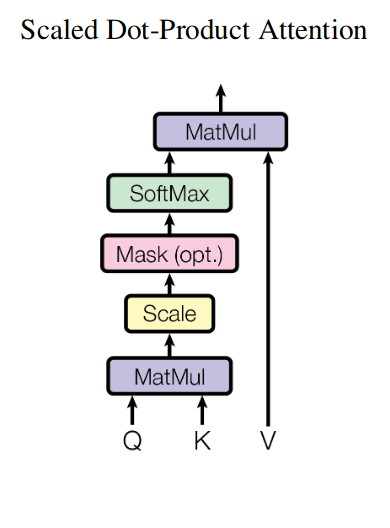

In [28]:
Image("./img/scaled_dot_product_attention_only.png")

Attention input is a list of 3 queries, 3 keys and 3 values, where each individual query, key and value is an embedding vector of dimensionality e.g. 256. 

$Q = \begin{pmatrix} q_{1,1} && q_{1,2} && ... && q_{1,256} \\ q_{2,1} && q_{2,2} && ... && q_{2,256} \\ q_{3, 1} && q_{3, 2} && ... && q_{3, 256} \end{pmatrix}$,

$K = \begin{pmatrix} k_{1,1} && k_{1,2} && ... && k_{1,256} \\ k_{2,1} && k_{2,2} && ... && k_{2,256} \\ k_{3, 1} && k_{3, 2} && ... && k_{3, 256} \end{pmatrix}$, 

$V = \begin{pmatrix} v_{1,1} && v_{1,2} && ... && v_{1,256} \\ v_{2,1} && v_{2,2} && ... && v_{2,256} \\ v_{3, 1} && v_{3, 2} && ... && v_{3, 256} \end{pmatrix}$, 

Attention output is list of 3 values, where each value is replaced with its weighted sum with other values, where of sum element is high, if $Q_i$ similar to $K_j$:

$$Attention(Q_i, K_j, V_j) = Softmax(\frac{Q_i {K_j}^T}{\sqrt{256}}) V_j$$, 

where Softmax is given by:

$$p_i =  \frac{e^{E_i}}{\sum \limits_j e^{E_j}}$$

In [51]:
import torch
import torch.nn as nn
import torch.nn.functional as F


def attention(query, key, value, mask=None, dropout=None):
    """Compute 'Scaled Dot Product Attention'.
    
    Mostly stolen from: http://nlp.seas.harvard.edu/2018/04/03/attention.html.
    """

    # MatMul and Scale
    d_k = query.size(-1)
    scores = torch.matmul(query, key.transpose(-2, -1)) / math.sqrt(d_k)
    
    # Mask (optional)
    if mask is not None:
        scores = scores.masked_fill(mask == 0, -1e9)
    
    # Softmax
    p_attn = F.softmax(scores, dim = -1)
    
    # MatMul
    if dropout is not None:
        p_attn = dropout(p_attn)
    
    return torch.matmul(p_attn, value), p_attn

## Multi-head attention
Now suppose that you have an input row of $n$ data vectors:

$X = \begin{pmatrix} x_{1,1} && x_{2,1} && ... && x_{n,1} \\ x_{1,2} && x_{2,2} && ... && x_{n,256} \\ x_{1, 256} && x_{2, 256} && ... && x_{n, 256} \end{pmatrix}$

You want to learn various interactions between its rows.

For each kind of interaction you'd learn, you project each column of your vector onto a different space called *representation space*, so that choice of representation space reflected some aspect of relation between rows, you want to establish, and apply scaled dot product attention.

A separate projection matrix followed by attention mechanism is called *attention head* then. Multihead attention with $h$ heads finds $h$ different ways, rows interact with each other.

For each head $h$ let us denote matrix of projection onto its representation space $W_h$. Suppose that dimensionality of our representation space is 64:

$W_h = \begin{pmatrix} w_{1,1} && w_{1,2} && ... && w_{1,256} \\ w_{2,1} && w_{2,2} && ... && w_{2,256} \\ ... \\ w_{64, 1} && w_{64, 2} && ... && w_{64, 256} \\ \end{pmatrix}$

So projection of vector $X_i = \begin{pmatrix} x_{i,1} \\ x_{i,2} \\ ... \\ x_{i, 256} \end{pmatrix}$ onto representation space $W_h$ is:

$W_h X_i = \begin{pmatrix} w_{1,1} && w_{1,2} && ... && w_{1,256} \\ w_{2,1} && w_{2,2} && ... && w_{2,256} \\ ... \\ w_{64, 1} && w_{64, 2} && ... && w_{64, 256} \\ \end{pmatrix} \begin{pmatrix} x_{i,1} \\ x_{i,2} \\ ... \\ x_{i,256} \end{pmatrix}$

In case of self-attention, $Q_i = K_i = V_i = W_h X_i$


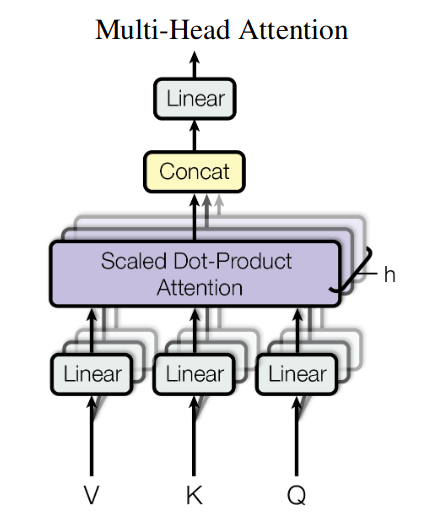

In [34]:
Image("./img/multihead_attention.png")

After application of multihead attention to all the inputs, the results from all heads are concatenated ("Concat" block on the picture). 

Then they are again aggregated into a weighted sum by a matrix multiplication ("Linear" block on the picture).

This was a single attention layer. As a result of its application, each column of matrix $X_i$ is enriched with a weighted sum of its interactions with other columns $X_j$.

In [48]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class MultiHeadedAttention(nn.Module):
    """Mostly stolen from: http://nlp.seas.harvard.edu/2018/04/03/attention.html."""
    
    def __init__(self, h, d_model, dropout=0.1):
        "Take in model size and number of heads."
        super(MultiHeadedAttention, self).__init__()
        
        assert d_model % h == 0
        
        # We assume d_v always equals d_k
        self.d_k = d_model // h
        self.h = h
        self.linears = clones(nn.Linear(d_model, d_model), 4)
        self.attn = None
        self.dropout = nn.Dropout(p=dropout)
        
    def forward(self, query, key, value, mask=None):
        """Implements multihead attention"""
        if mask is not None:
            # Same mask applied to all h heads.
            mask = mask.unsqueeze(1)

        nbatches = query.size(0)
        
        # 1) Do all the linear projections in batch from d_model => h x d_k 
        query, key, value = \
            [l(x).view(nbatches, -1, self.h, self.d_k).transpose(1, 2)
             for l, x in zip(self.linears, (query, key, value))]
        
        # 2) Apply attention on all the projected vectors in batch. 
        x, self.attn = attention(query, key, value, mask=mask, dropout=self.dropout)
        
        # 3) "Concat" using a view and apply a final linear. 
        x = x.transpose(1, 2).contiguous().view(nbatches, -1, self.h * self.d_k)

        return self.linears[-1](x)

# Evoformer: MSA representation update part

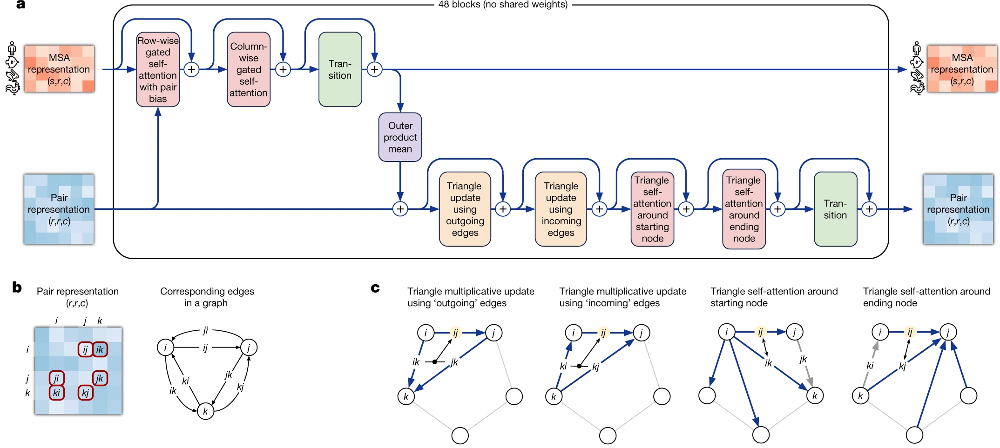

In [40]:
Image("./img/evoformer.png", width=1280)

## Axial (a.k.a criss-cross) attention mechanism in Evoformer
* Suggested in visual transformers circa 2020
* A frugal alternative to CNNs and full 2D attention

## Row-wise gated self-attention

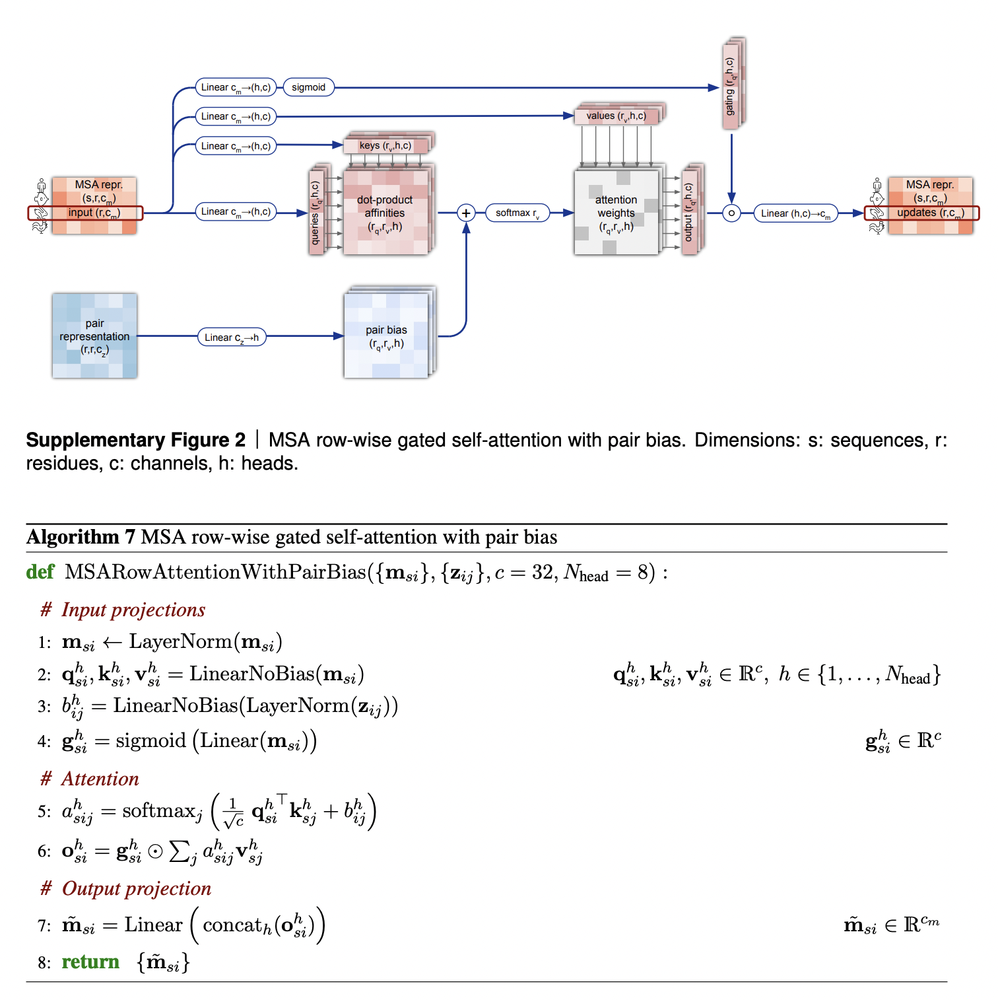

In [49]:
Image("./img/row_wise_self_attention.png")

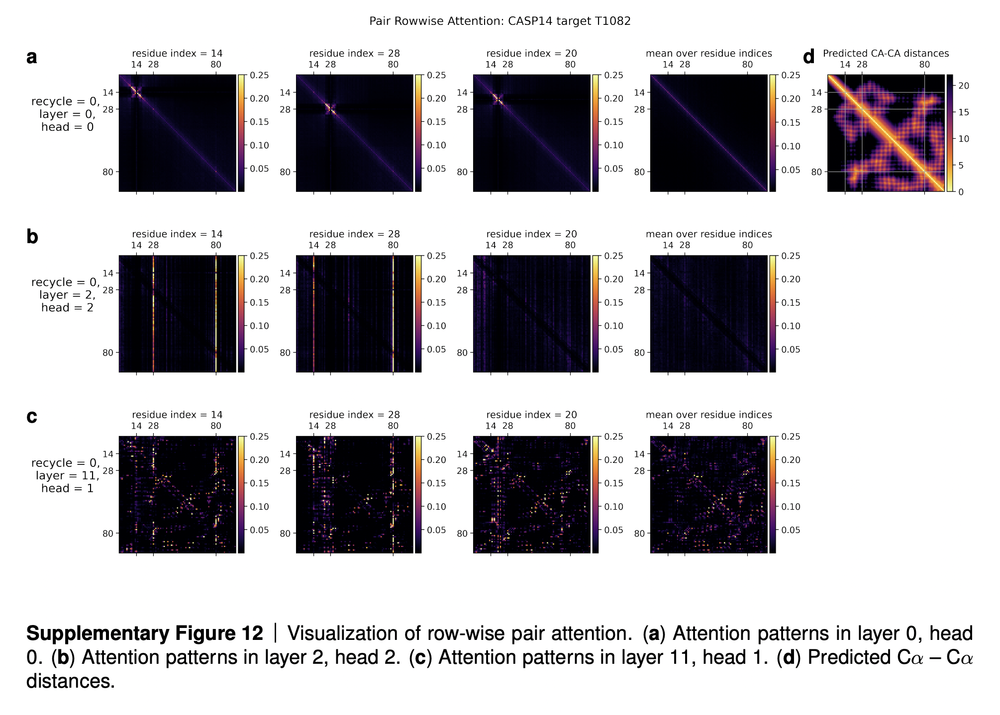

In [53]:
Image("./img/row_wise_attention_visualisation.png")

> In this section we are going to analyse a small subset of the attention patterns we see in the main part of
the model. This will be restricted to relatively short proteins with fairly shallow MSA’s in order for easier
visualization.

> We are going to examine the attention weights in the attention on the pair representation in the “Triangular
gated self-attention around starting node” (Algorithm 13). The attention pattern for a given head h is a third
order tensor a
h
ijk (line 5 of Algorithm 13), here we will investigate different slices along the i axis as well as
averages along this axis, and display the jk array as a heat map. We specify the attention pattern for a specific
head by the recycling index r, layer index l and head index h. We show the attention patterns in Suppl. Fig. 12

> In layer 0, head 0 (Suppl. Fig. 12a) we see a pattern that is similar to a convolution, i.e. the pair representation at (i, i + j) attends to the pair representation (i, i + k), where j and k are relatively small and the pattern
is fairly independent of i. The radius of the pattern is 4 residues, we note that the hydrogen bonded residues
in an alpha helix are exactly 4 residues apart. Patterns like this are expected in early layers due to the relative
position encoding, however one would naively expect it to be wider, as the relative positions run to 32.


> In layer 2, head 2 (Suppl. Fig. 12b) we see a very specific attention pattern. We see that positions 14, 28
and 80 play a special role. These correspond to the positions of cysteine residues in the protein. We see that
at the cysteine positions the attention is localized to the other cysteine positions as exemplified by the bands
in the first two panels. Meanwhile away at positions different from the cysteine like position 20, we see that
the attention is devoid of features suggesting that the model does not use the attention at these positions. We
found this behaviour to be consistent across different positions and proteins, this possibly indicates finding
possible disulfides as a key feature of some heads.

> A head later in the network (Suppl. Fig. 12c) shows a rich, non-local attention pattern resembling the
Suppl. Material for Jumper et al. (2021): Highly accurate protein structure prediction with AlphaFold 55
distance between pairs in the structure (Suppl. Fig. 12d).

## Column-wise gated self-attention

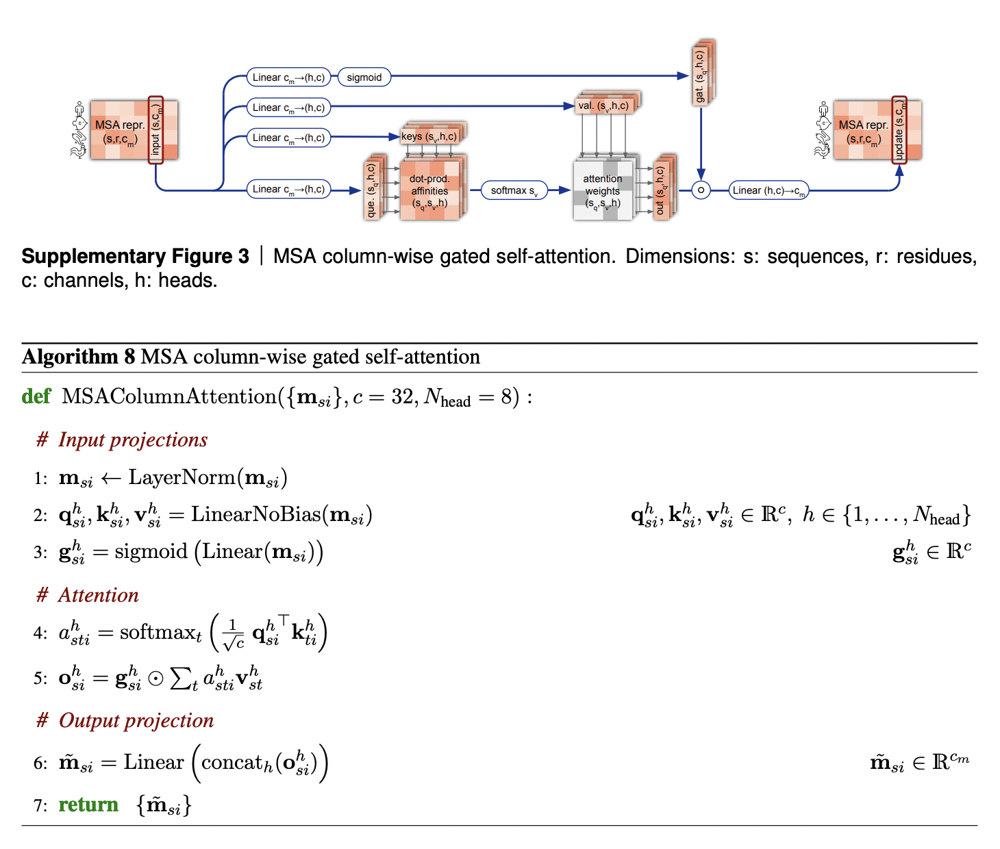

In [50]:
Image("./img/column_wise_self_attention.png")

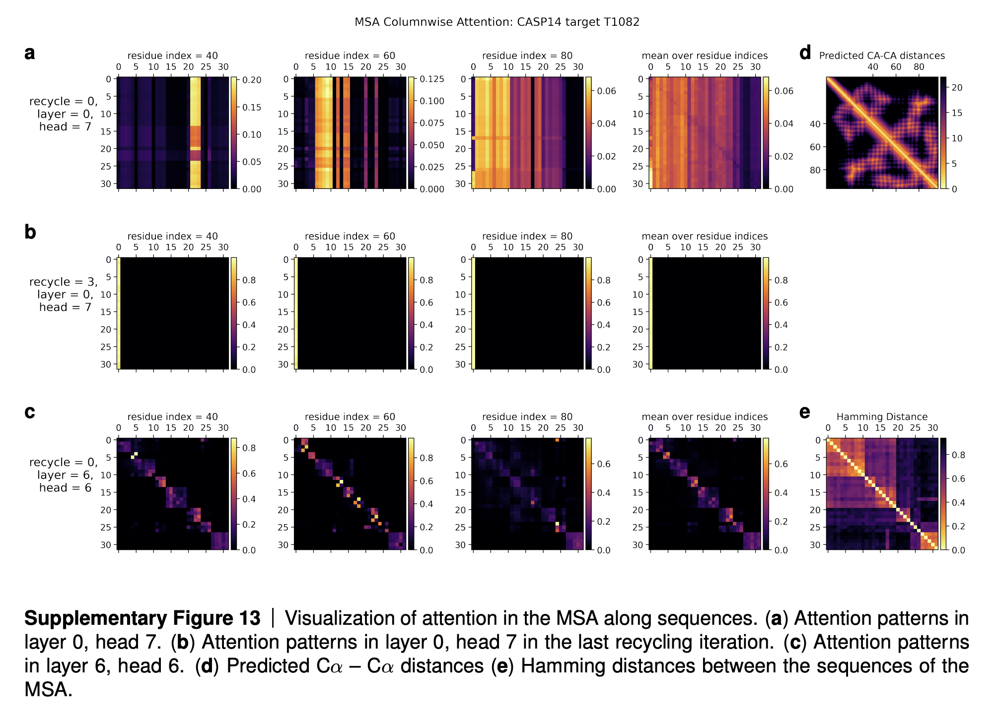

In [55]:
Image("./img/column_wise_attention_visualisation.png")

> In Suppl. Fig. 13 we show a visualization of the attention pattern in the MSA along the columns a
$h_{sti}$ (line 4
of Algorithm 8). We slice along the last axis $i$ and display the $st$ array as heat map.

> The original MSA subset shown to the main part of the model is randomly sampled. As such the order is
random except for the first row. The first row is special because it contains the target sequence and is recycled
in consecutive iterations of the model. Due to the shallow MSA of this protein, the random subset leads to
a random permutation of the sequences. In order to facilitate easier interpretation of the attention patterns
here we reorder the attention tensor by using a more suitable order for the MSA. We perform a hierarchical
clustering using the Ward method with simple Hamming distance as a metric and use the output to re-index
the sequence dimension in the MSA attention tensor. We resort the indices from the hierarchical clustering
manually to keep the target sequence in the first row. This manual sorting is done in such a way as to keep the
tree structure valid. The Hamming distances between the reordered sequences (see Suppl. Fig. 13e) show a
block-like structure quite clearly after the reordering.

> The attention pattern in the first layer of the network in the first recycling iteration (e.g. layer 0, head 7 in
Suppl. Fig. 13a) is not very informative and is largely averaging as can be seen by looking at the range of the
attention weights.

> In the same head, but in the last recycling iteration (Suppl. Fig. 13b) we see that all sequences at all positions
attend to the first row. Therefore this head behaves differently upon recycling and is presumably important for
distribution the information in the recycled first row to the rest of the MSA representation.
Layer 6, head 6 (Suppl. Fig. 13c) shows a pattern that is fairly common in the column-wise MSA attention,
here the pattern only varies lightly as one goes along the sequence and there is a clear structure in blocks of
sequences that attend to each other. We note that these seem somewhat similar to the blocks derived from hierarchical clustering using Hamming distance.
Whether attention patterns provide a good explanation for the behaviour of a given model or are predictive
of interventions into the model is a topic of debate in the community, see [127], [128], [129]. A detailed
analysis of the generality and predictivity of these attention patterns is beyond the scope of this paper.

## Evoformer: Pair representation update from updated MSA representation via outer product mean

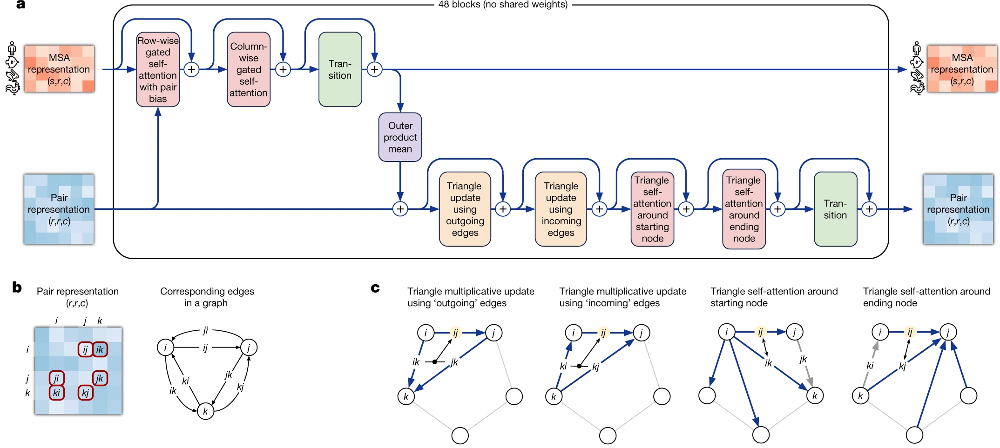

In [42]:
Image("./img/evoformer.png", width=1280)

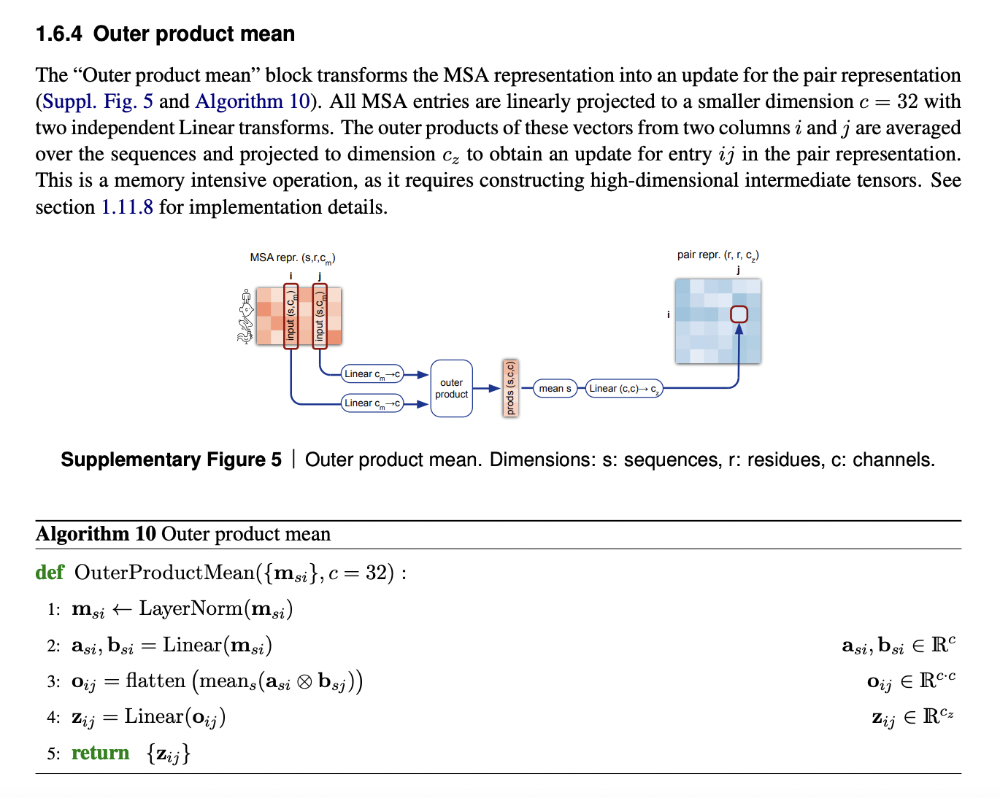

In [45]:
Image("./img/outer_product_mean.png")

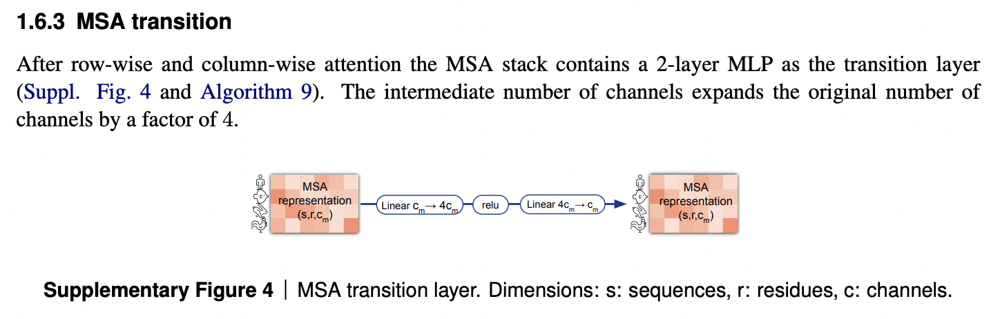

In [52]:
Image("./img/msa_transition.png")

# Evoformer: Triangle inequalities as natural constraints for pair distances

* Triangle inequalities on distances need to be enforced in order to ensure consistency. 
* From the ML engineering standpoint triangle inequalities are implemented as soft constraints rather than hard constraints.
* Initially triangle updates using outgoin/incoming edges were devised as a frugal alternative to triangle self-attention blocks. Either of these modules could be removed, and resulting model still performs well. However, SOTA is achieved when both modules are present.

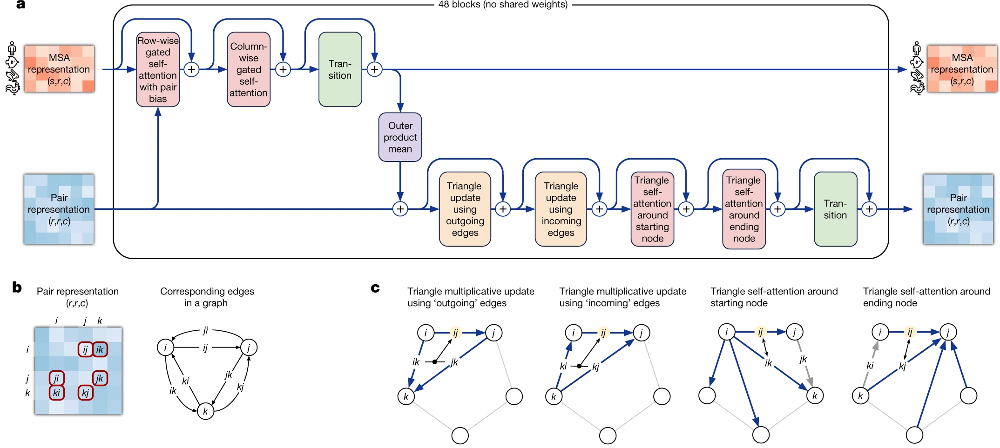

In [41]:
Image("./img/evoformer.png", width=1280)

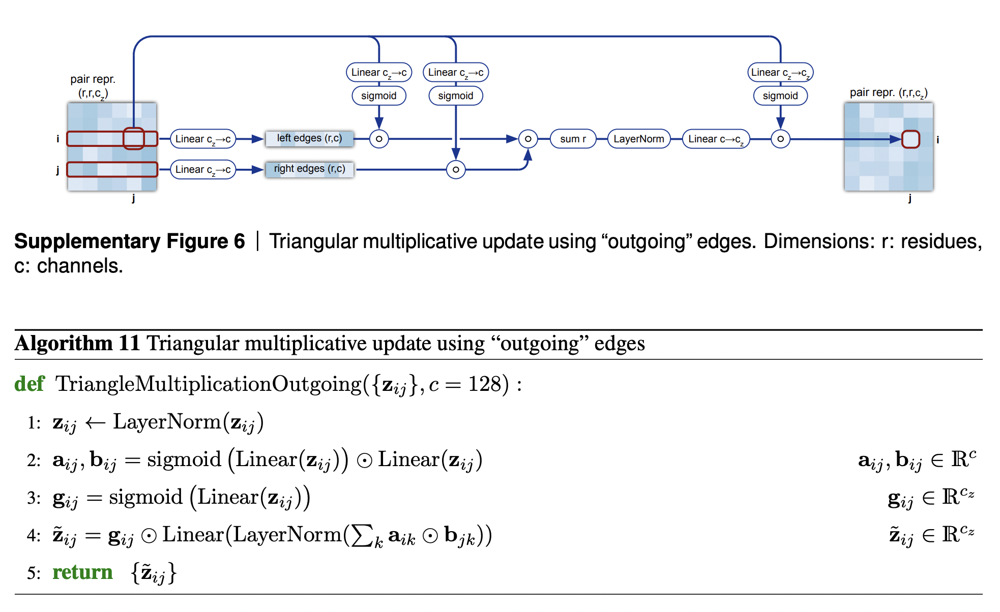

In [57]:
Image("./img/triangular_multiplicative_update.png")

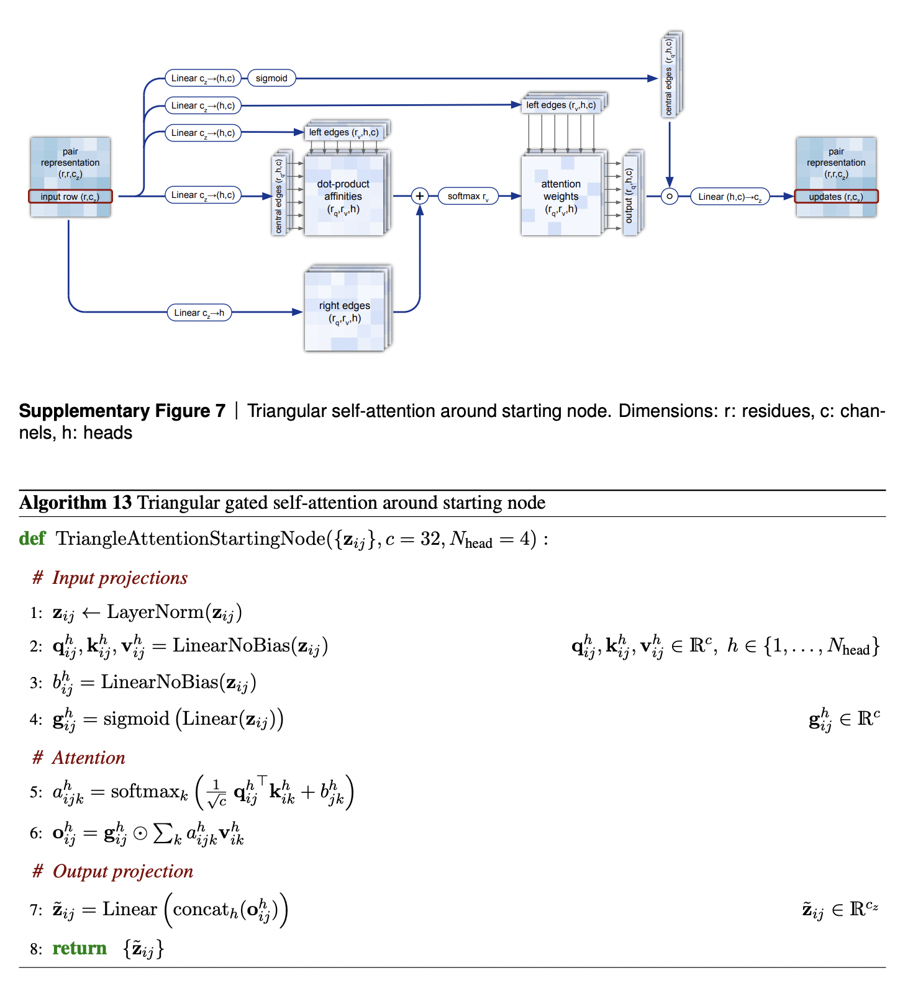

In [59]:
Image("./img/triangular_self_attention.png")

# Structural module

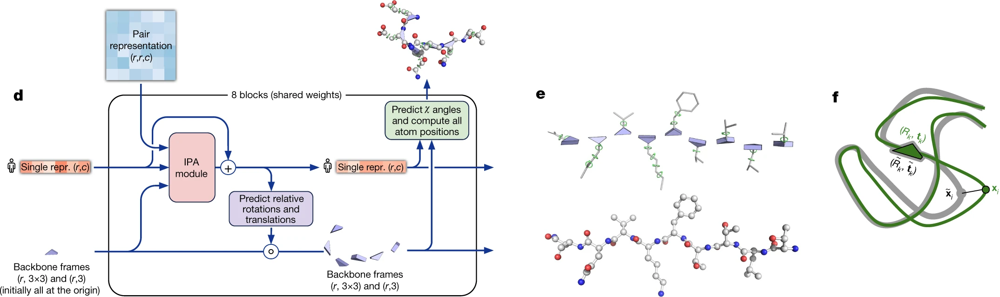

In [25]:
Image("./img/structural_module.png", width=1280)

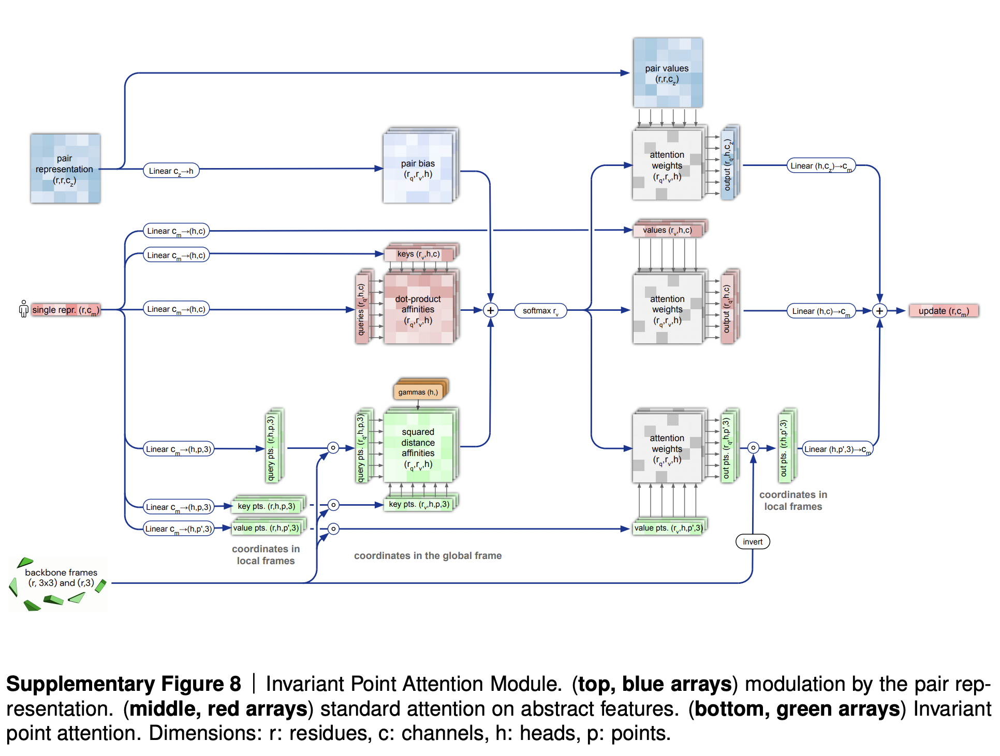

In [56]:
Image("./img/IPA.png")

## Refinement a.k.a. "recycling" 

Application of a computer vision approach (see [Human Pose Estimation](https://arxiv.org/pdf/1507.06550.pdf) paper).

Turns out, recycling almost renders IPA unnecessary. Absense of recycling makes final score much worse, while absense of IPA does not affect the performance as much (see Ablation study).

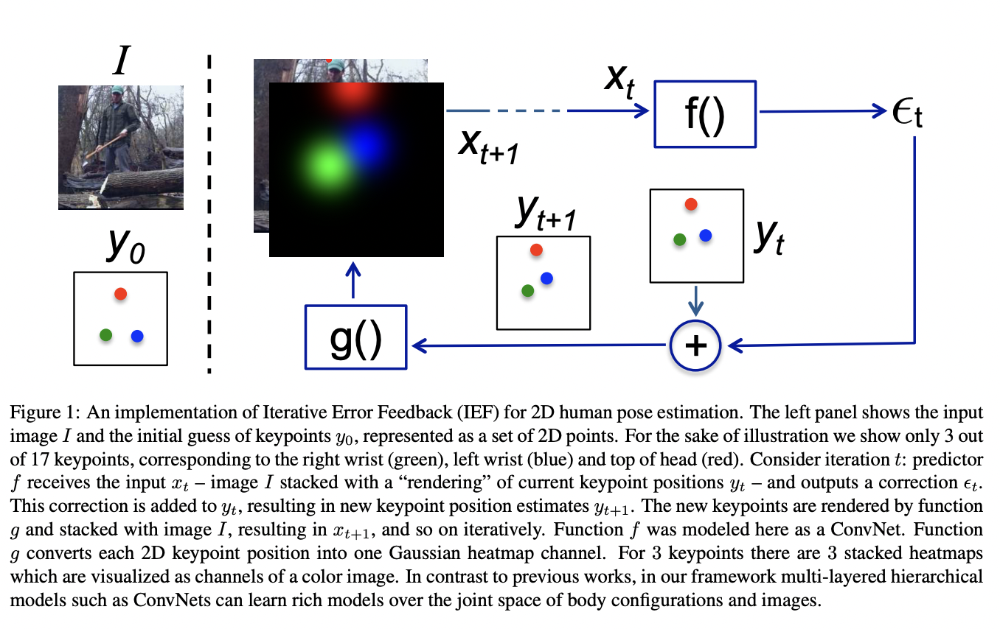

In [61]:
Image("./img/refinement.png", width=1080)

# Self-distillation

Employs both semi-supervised and self-supervised approaches.

## Noisy Student Training

See [Self-training with Noisy Student improves ImageNet classification](https://arxiv.org/pdf/1911.04252v4.pdf) paper. 

Allowed to set new SOTA on ImageNet, improving top-1 accuracy by 2% to 88.4% by utilizing semi-supervised learning using unlabled images.

Noisy Student Training is a semi-supervised learning approach. It extends the idea of self-training and distillation with the use of equal-or-larger student models and noise added to the student during learning. It has three main steps:

 1. train a teacher model on labeled images
 2. use the teacher to generate pseudo labels on unlabeled images
 3. train a student model on the combination of labeled images and pseudo labeled images.
 
The algorithm is iterated a few times by treating the student as a teacher to relabel the unlabeled data and training a new student.

Noisy Student Training seeks to improve on self-training and distillation in two ways. First, it makes the student larger than, or at least equal to, the teacher so the student can better learn from a larger dataset. Second, it adds noise to the student so the noised student is forced to learn harder from the pseudo labels. To noise the student, it uses input noise such as RandAugment data augmentation, and model noise such as dropout and stochastic depth during training.

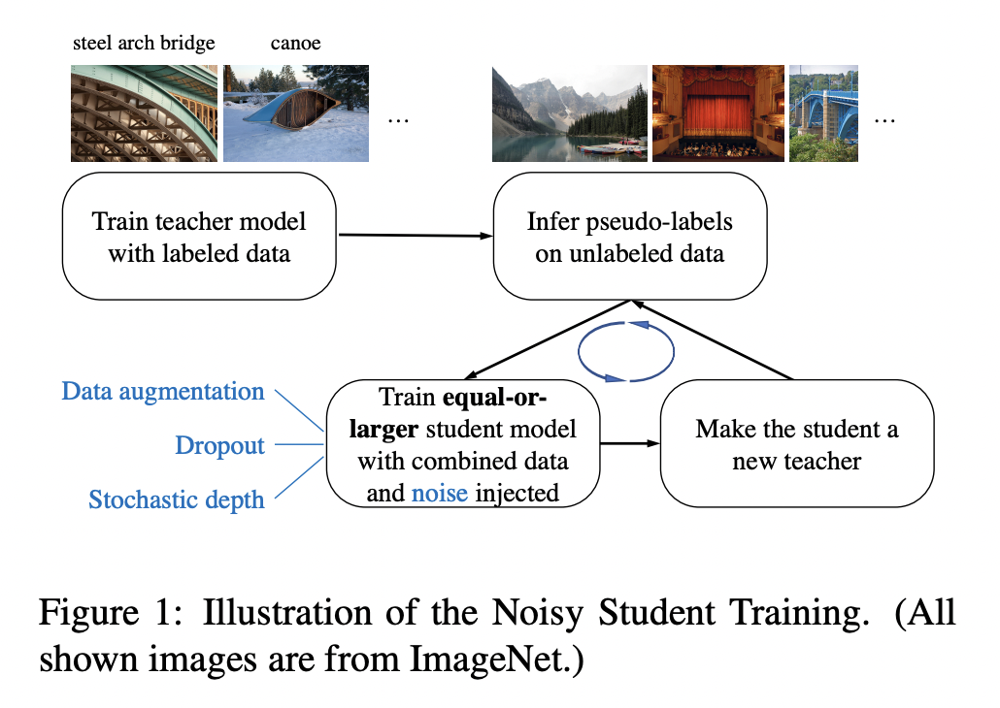

In [62]:
Image("./img/noisy_student_training.png")

### BERT-like prediction of MSA positions
Self-supervised approach, simliar to BERT approach. 

Mask-out or mutate a position of alignment and let the network recover it. Incorporate an auxiliary loss for the quality of recovery.

Similar to [MSA transformer](https://www.biorxiv.org/content/10.1101/2021.02.12.430858v1.full) by Facebook.

## FAPE loss and auxiliary losses

Weighted average of multiple losses.

* $\mathcal{L}_{FAPE}$ is FAPE loss
* $\mathcal{L}_{aux}$ is a loss from auxillary metrics in structure module
* $\mathcal{L}_{dist}$ is loss from distogram prediction
* $\mathcal{L}_{msa}$ is a loss from BERT-like masked MSA position prediction
* $\mathcal{L}_{conf}$ is a loss from model confidence pLDDT prediction
* $\mathcal{L}_{exp_resolved}$ is a loss from a head, predicting, if structure comes from a highly accurate experimental prediction, such as CryoEM or high-resolution X-ray crystallography
* $\mathcal{L}_{viol}$ is a loss for structural violations; penalizes unlikely lengths of bonds, torsion angles and sterically clashing atoms, even if ground truth structure is unavailable 

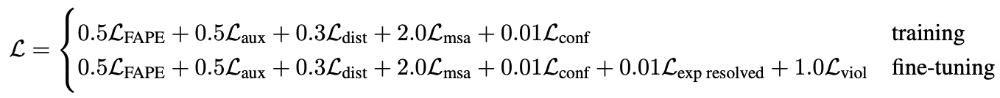

In [72]:
Image("./img/AF2_losses.png", width=1080)

## Training protocol
AF2 was trained on TPUv3 for about a week and than fine-tuned for 4 days.

Interestingly, the model training requires 20GB video memory, while TPUv3 provides only 16GB. Hack: partially forget activations after forward pass and re-calculate them on backward pass. Essentially sacrifice FLOPS for VRAM.

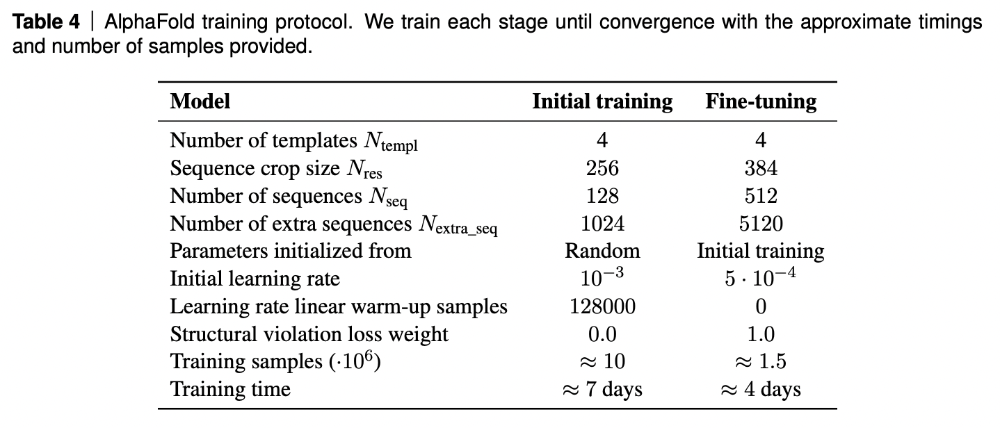

In [69]:
Image("./img/AF2_training.png")

## Ablation study

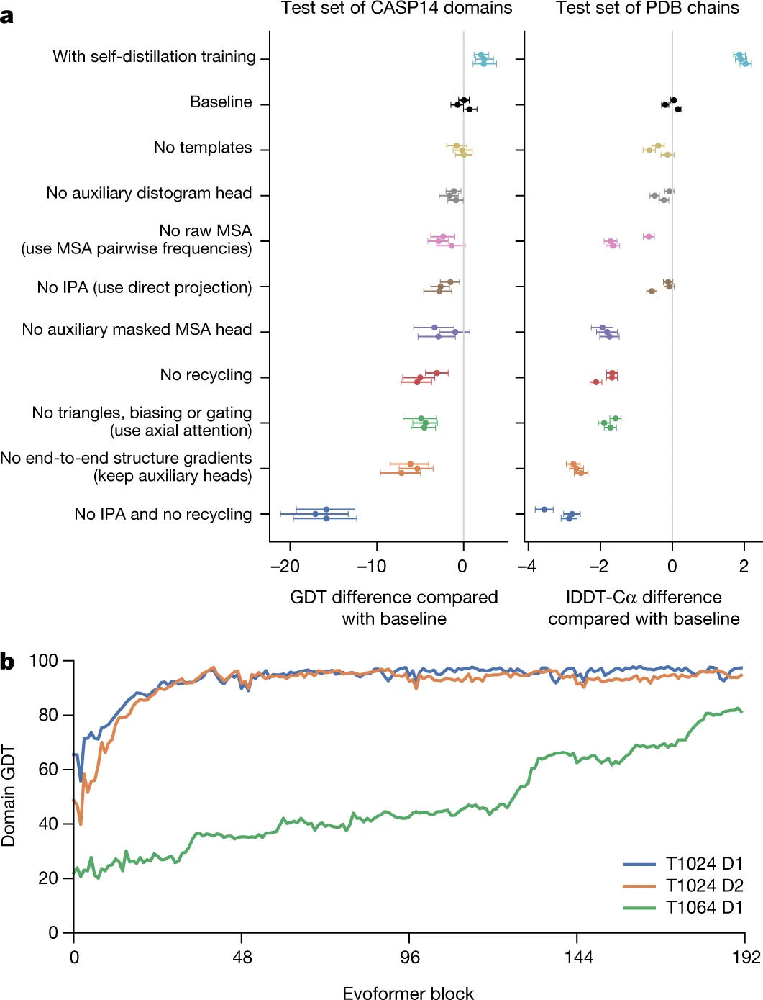

In [44]:
Image("./img/AF2_ablations.png")

## References
* https://www.nature.com/articles/s41586-021-03819-2 - original AlphaFold2 paper
* https://static-content.springer.com/esm/art%3A10.1038%2Fs41586-021-03819-2/MediaObjects/41586_2021_3819_MOESM1_ESM.pdf - AlphaFold2 paper supplementary
* https://github.com/deepmind/alphafold - AlphaFold2 source code
* https://moalquraishi.wordpress.com/2021/07/25/the-alphafold2-method-paper-a-fount-of-good-ideas/ - blog post by Mohammed Al Quraishi
* http://nlp.seas.harvard.edu/2018/04/03/attention.html - annotated transformer notebook
* https://arxiv.org/pdf/1912.00349.pdf - "Not All Attention Is Needed: Gated Attention Network for Sequence Data" paper
* https://openaccess.thecvf.com/content_ECCV_2018/papers/Pau_Rodriguez_Lopez_Attend_and_Rectify_ECCV_2018_paper.pdf - "Attend and Rectify: a Gated Attention
Mechanism for Fine-Grained Recovery." paper
* https://arxiv.org/pdf/1811.11721v2.pdf - "CCNet: Criss-Cross Attention for Semantic Segmentation" paper
* https://arxiv.org/pdf/2102.10662.pdf - "Medical Transformer: Gated Axial-Attention for Medical Image Segmentation" paper
* https://www.youtube.com/watch?v=Uk7m93V14KA - a talk on Medical Transformer
* https://arxiv.org/pdf/1802.08219.pdf - "Tensor field networks: Rotation- and translation-equivariant neural networks for 3D point clouds" paper 
* https://arxiv.org/pdf/2006.10503.pdf - "SE(3)-Transformers: 3D Roto-Translation Equivariant Attention Networks" paper by Max Welling group
* https://papers.nips.cc/paper/2019/file/f3a4ff4839c56a5f460c88cce3666a2b-Paper.pdf - "Generative models for graph-based protein design" paper
* https://arxiv.org/pdf/1507.06550.pdf - "Human Pose Estimation with Iterative Error Feedback" paper
* https://arxiv.org/pdf/1911.04252.pdf - "Self-training with Noisy Student improves ImageNet classification" paper
* https://www.biorxiv.org/content/10.1101/2021.02.12.430858v1.full - MSA Transformer paper by Pieter Abbeel
* https://www.ddw-online.com/media/32/03.sum.the-cost-and-value-of-three-dimensional-protein-structure.pdf - on cost and value of experimental protein 3D structure recovery (2003)